# Inference on Real world Dataset using pretrained models and Fine tuned model

## 1. Pre-trained Model

In [21]:
import torch
from torchvision.models.detection import fasterrcnn_resnet50_fpn, maskrcnn_resnet50_fpn, retinanet_resnet50_fpn, ssdlite320_mobilenet_v3_large
from torchvision import transforms
from PIL import Image
import numpy as np
import json
import os
import cv2

from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
from math import sqrt
import time

with open('ground_truth.json', 'r') as file:
	ground_dict = json.load(file)

y_pred = []
y_true = []

# Check if CUDA is available
if torch.cuda.is_available():
    device = torch.device("cuda")
    print("CUDA is available. Model will be moved to GPU.")
else:
    device = torch.device("cpu")
    print("CUDA is not available. Model will run on CPU.")

# Models to evaluate
models = {
    "Faster R-CNN": fasterrcnn_resnet50_fpn(pretrained=True),
    "Mask R-CNN": maskrcnn_resnet50_fpn(pretrained=True),
    "RetinaNet": retinanet_resnet50_fpn(pretrained=True),
    #"SSD": ssdlite320_mobilenet_v3_large(pretrained=True),  # SSD variant from torchvision
}
	
# Load your image
test_dataset_path = "/home/local/ASURITE/tchen169/Documents/CV4TSC/rough/RL_Model/Arpit-Data/Dataset_collection/test_dataset/"

def save_detections_in_image(image_path, model, device):
	# Load and transform the image
	image = cv2.imread(image_path)
	transform = transforms.Compose([transforms.ToTensor()])
	image_tensor = transform(image).to(device)
	
	# Get predictions from the model
	with torch.no_grad():
		prediction = model([image_tensor])

	vehicle_labels = [2, 3, 4, 6, 8]
	# Convert vehicle_labels list to a tensor and move it to the same device as the model's predictions
	vehicle_labels_tensor = torch.tensor(vehicle_labels).to(prediction[0]['labels'].device)

	if len(prediction) > 0:
		car_indices = torch.isin(prediction[0]['labels'], vehicle_labels_tensor) & (prediction[0]['scores'] > 0.5)
		car_boxes = prediction[0]['boxes'][car_indices].cpu().numpy()
		# print(len(car_boxes))
		
		for box in car_boxes:
			x1, y1, x2, y2 = box.astype(int)
			# Draw bounding box
			cv2.rectangle(image, (x1, y1), (x2, y2), (0, 0, 255), 2)
	
	# Save the modified image
	inference_directory = "/home/local/ASURITE/tchen169/Documents/CV4TSC/rough/RL_Model/Arpit-Data/Dataset_collection/inference_results/"
	save_path = os.path.join(inference_directory, os.path.basename(image_path))
	cv2.imwrite(save_path, image)

	return len(car_boxes)

# Evaluation loop
for model_name, model in models.items():
	y_pred = []
	y_true = []

	model.eval()
	model.to(device)
	for filename in os.listdir(test_dataset_path):
		img_path = os.path.join(test_dataset_path, filename)
		predicted_output = save_detections_in_image(img_path, model, device)
		# print(f"File: {os.path.basename(img_path)} detection: {predicted_output} GT {ground_dict[os.path.basename(img_path)]}")
		y_pred.append(predicted_output)
		y_true.append(ground_dict[os.path.basename(img_path)])
	print("Model Name:", model_name)
	print("rmse results:",sqrt(mean_squared_error(y_true,y_pred)))
	print("mse results:",mean_squared_error(y_true,y_pred))
	print("mae results:",mean_absolute_error(y_true,y_pred))

CUDA is available. Model will be moved to GPU.


/home/local/ASURITE/tchen169/anaconda3/envs/carla-prithvi/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/local/ASURITE/tchen169/anaconda3/envs/carla-prithvi/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/home/local/ASURITE/tchen169/anaconda3/envs/carla-prithvi/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The curre

Model Name: Faster R-CNN
rmse results: 4.236744032862972
mse results: 17.95
mae results: 3.4
Model Name: Mask R-CNN
rmse results: 3.80460247594936
mse results: 14.475
mae results: 2.875
Model Name: RetinaNet
rmse results: 1.3133925536563698
mse results: 1.725
mae results: 0.975


## 2. Fine Tuned MOdel

In [1]:
import torch
import torchvision
from functools import partial
from torchvision.models.detection import RetinaNet_ResNet50_FPN_V2_Weights
from torchvision.models.detection.retinanet import RetinaNetClassificationHead
from torchvision import transforms
from PIL import Image
import numpy as np
import json
import os
import cv2

from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
from math import sqrt
import time

with open('ground_truth.json', 'r') as file:
	ground_dict = json.load(file)
	

def create_model(num_classes, model_path):
    model = torchvision.models.detection.retinanet_resnet50_fpn_v2(
        weights=RetinaNet_ResNet50_FPN_V2_Weights.COCO_V1
    )
    num_anchors = model.head.classification_head.num_anchors

    model.head.classification_head = RetinaNetClassificationHead(
        in_channels=256,
        num_anchors=num_anchors,
        num_classes=num_classes,
        norm_layer=partial(torch.nn.GroupNorm, 32)
    )
    model_dict = torch.load(model_path)
    model.load_state_dict(model_dict["model_state_dict"])
    print("what is the epoch:",model_dict['epoch'])
    return model

# Check if CUDA is available
if torch.cuda.is_available():
    device = torch.device("cuda")
    print("CUDA is available. Model will be moved to GPU.")
else:
    device = torch.device("cpu")
    print("CUDA is not available. Model will run on CPU.")

# Models to evaluate
models = {
    # "RetinaNet fine tuned on Carla": create_model(2, model_path = "/home/local/ASURITE/tchen169/Documents/CV4TSC/rough/RL_Model/Fine_Tuning_Model/outputs/best_model_backup2.pth"),
    "RetinaNet fine tuned on Carla and object detection model": create_model(2, model_path = "/home/local/ASURITE/tchen169/Documents/CV4TSC/rough/RL_Model/Integrated_Fine_Tuning_Model/outputs/best_model.pth")
}
	
# Load your image
test_dataset_path = "/home/local/ASURITE/tchen169/Documents/CV4TSC/rough/RL_Model/Arpit-Data/Dataset_collection/test_dataset/"

def save_detections_in_image(image_path, model, device):
	# Load and transform the image
	image = cv2.imread(image_path)
	transform = transforms.Compose([transforms.ToTensor()])
	image_tensor = transform(image).to(device)
	
	# Get predictions from the model
	with torch.no_grad():
		prediction = model([image_tensor])
	# print(prediction)

	if len(prediction) > 0:
		car_indices = (prediction[0]['scores']> 0.5).nonzero(as_tuple=True)[0]
		car_boxes = prediction[0]['boxes'][car_indices].cpu().numpy()
		# print(len(car_boxes))
		
		for box in car_boxes:
			x1, y1, x2, y2 = box.astype(int)
			# Draw bounding box
			cv2.rectangle(image, (x1, y1), (x2, y2), (0, 0, 255), 2)
	
	# Save the modified image
	inference_directory = "/home/local/ASURITE/tchen169/Documents/CV4TSC/rough/RL_Model/Arpit-Data/Dataset_collection/inference_results/"
	save_path = os.path.join(inference_directory, os.path.basename(image_path))
	cv2.imwrite(save_path, image)

	return len(car_boxes)

# Evaluation loop
for model_name, model in models.items():
	y_pred = []
	y_true = []

	model.eval()
	model.to(device)
	for filename in os.listdir(test_dataset_path):
		img_path = os.path.join(test_dataset_path, filename)
		predicted_output = save_detections_in_image(img_path, model, device)
		# print(f"File: {os.path.basename(img_path)} detection: {predicted_output} GT {ground_dict[os.path.basename(img_path)]}")
		y_pred.append(predicted_output)
		y_true.append(ground_dict[os.path.basename(img_path)])
	print("Model Name:", model_name)
	print("rmse results:",sqrt(mean_squared_error(y_true,y_pred)))
	print("mse results:",mean_squared_error(y_true,y_pred))
	print("mae results:",mean_absolute_error(y_true,y_pred))

CUDA is available. Model will be moved to GPU.
what is the epoch: 5
Model Name: RetinaNet fine tuned on Carla and object detection model
rmse results: 1.4053469322555197
mse results: 1.975
mae results: 0.975


In [32]:
print(y_pred)
print(y_true)

[1, 10, 3, 3, 5, 2, 0, 4, 1, 10, 4, 2, 1, 2, 7, 0, 6, 0, 5, 2, 2, 1, 2, 2, 1, 1, 8, 4, 3, 4, 4, 0, 4, 1, 0, 3, 6, 2, 4, 5]
[2, 12, 3, 4, 3, 4, 2, 4, 2, 12, 4, 1, 3, 3, 8, 0, 8, 0, 6, 2, 2, 1, 3, 3, 3, 0, 6, 4, 4, 3, 4, 2, 4, 1, 0, 4, 7, 2, 4, 10]


## Integrated Fine tune model test on Carla dataset

/home/local/ASURITE/tchen169/anaconda3/envs/carla-prithvi/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/local/ASURITE/tchen169/anaconda3/envs/carla-prithvi/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/home/local/ASURITE/tchen169/anaconda3/envs/carla-prithvi/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The curre

CUDA is available. Model will be moved to GPU.
New path: /home/local/ASURITE/tchen169/Documents/CV4TSC/rough/RL_Model/cyclic_traffic_time_for_train/1fpsDataset/A/1700.jpg
Predicted [0, 0] GT [1, 0]
New path: /home/local/ASURITE/tchen169/Documents/CV4TSC/rough/RL_Model/cyclic_traffic_time_for_train/1fpsDataset/B/1700.jpg
Predicted [0, 1] GT [0, 1]
New path: /home/local/ASURITE/tchen169/Documents/CV4TSC/rough/RL_Model/cyclic_traffic_time_for_train/1fpsDataset/C/1700.jpg
Predicted [1, 2] GT [3, 2]
New path: /home/local/ASURITE/tchen169/Documents/CV4TSC/rough/RL_Model/cyclic_traffic_time_for_train/1fpsDataset/D/1700.jpg
Predicted [0, 0] GT [0, 1]
New path: /home/local/ASURITE/tchen169/Documents/CV4TSC/rough/RL_Model/cyclic_traffic_time_for_train/1fpsDataset/A/1701.jpg
Predicted [1, 0] GT [1, 0]
New path: /home/local/ASURITE/tchen169/Documents/CV4TSC/rough/RL_Model/cyclic_traffic_time_for_train/1fpsDataset/B/1701.jpg
Predicted [0, 1] GT [0, 1]
New path: /home/local/ASURITE/tchen169/Document

/tmp/ipykernel_445453/1568920752.py:110: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1)


Predicted [0, 0] GT [0, 1]
New path: /home/local/ASURITE/tchen169/Documents/CV4TSC/rough/RL_Model/cyclic_traffic_time_for_train/1fpsDataset/A/1703.jpg
Predicted [1, 1] GT [1, 1]
New path: /home/local/ASURITE/tchen169/Documents/CV4TSC/rough/RL_Model/cyclic_traffic_time_for_train/1fpsDataset/B/1703.jpg
Predicted [0, 1] GT [0, 1]
New path: /home/local/ASURITE/tchen169/Documents/CV4TSC/rough/RL_Model/cyclic_traffic_time_for_train/1fpsDataset/C/1703.jpg
Predicted [1, 2] GT [3, 2]
New path: /home/local/ASURITE/tchen169/Documents/CV4TSC/rough/RL_Model/cyclic_traffic_time_for_train/1fpsDataset/D/1703.jpg
Predicted [0, 0] GT [0, 1]
New path: /home/local/ASURITE/tchen169/Documents/CV4TSC/rough/RL_Model/cyclic_traffic_time_for_train/1fpsDataset/A/1704.jpg
Predicted [1, 1] GT [1, 1]
New path: /home/local/ASURITE/tchen169/Documents/CV4TSC/rough/RL_Model/cyclic_traffic_time_for_train/1fpsDataset/B/1704.jpg
Predicted [0, 1] GT [0, 1]
New path: /home/local/ASURITE/tchen169/Documents/CV4TSC/rough/RL_Mo

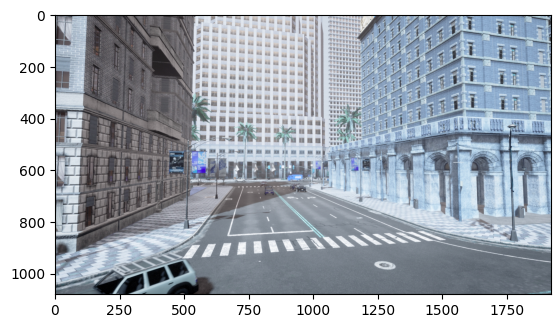

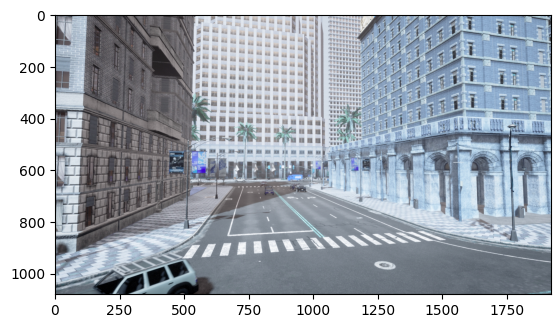

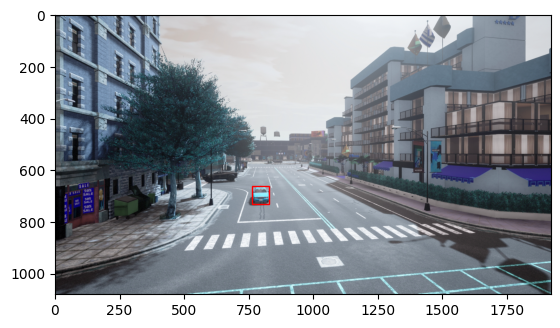

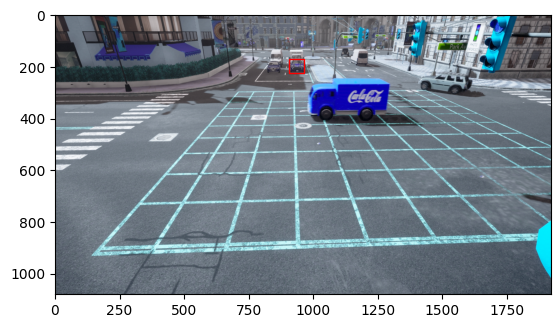

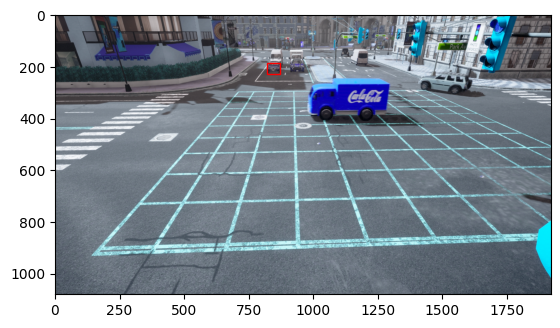

...

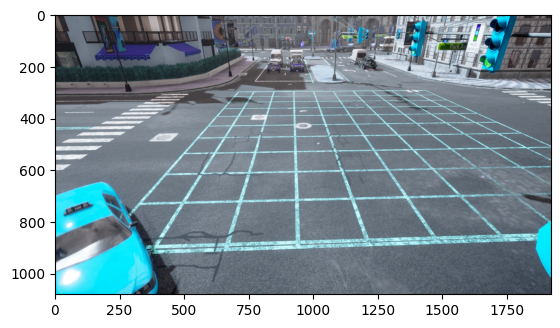

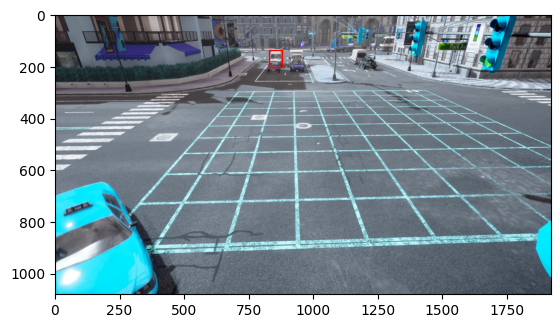

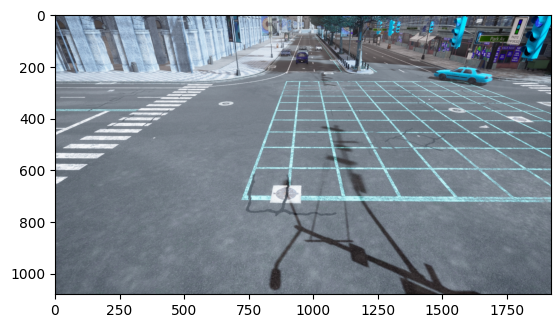

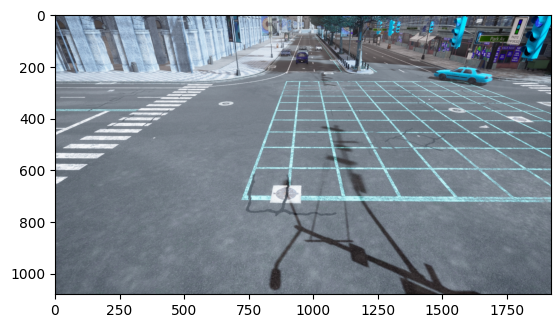

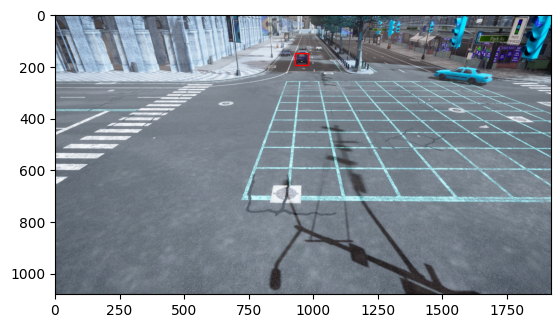

In [4]:
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
from math import sqrt
import time

import torch
from torchvision.models.detection import fasterrcnn_resnet50_fpn, maskrcnn_resnet50_fpn, retinanet_resnet50_fpn, ssdlite320_mobilenet_v3_large
import torchvision.transforms as transforms
from PIL import Image
import numpy as np
import json
import os
import cv2
import matplotlib.patches as patches
import matplotlib.pyplot as plt
# from transform import *

# Models to evaluate
models = {
	"Faster R-CNN": fasterrcnn_resnet50_fpn(pretrained=True),
	"Mask R-CNN": maskrcnn_resnet50_fpn(pretrained=True),
	"RetinaNet": retinanet_resnet50_fpn(pretrained=True),
	#"SSD": ssdlite320_mobilenet_v3_large(pretrained=True),  # SSD variant from torchvision
}

distance_threshold = 100

# Check if CUDA is available
if torch.cuda.is_available():
	device = torch.device("cuda")
	print("CUDA is available. Model will be moved to GPU.")
else:
	device = torch.device("cpu")
	print("CUDA is not available. Model will run on CPU.")

# Load lane cordinates
lane_file_path = "/home/local/ASURITE/tchen169/Documents/CV4TSC/Test/Lane_file_path.json"
with open(lane_file_path, 'r') as file:
	lane_2d_data = json.load(file)
		
# Load your image
json_file_path = "/home/local/ASURITE/tchen169/Documents/CV4TSC/rough/RL_Model/cyclic_traffic_time_for_train/1fpsDataset/Intersection_camera.json"

def processed_image_path(source_path, folder):
	destination_directory = '/home/local/ASURITE/tchen169/Documents/CV4TSC/rough/RL_Model/cyclic_traffic_time_for_train/1fpsDataset/'

	# Extract the filename
	filename = os.path.basename(source_path)

	# Construct the new path
	new_path = os.path.join(destination_directory, folder, filename)

	print("New path:", new_path)
	return new_path

def point_in_search_region(cx, cy, ax, ay, bx, by):
			# Compute the vectors C->B and A->B
			vector_CB = (bx - cx, by - cy)
			vector_AB = (bx - ax, by - ay)

			# Compute the dot product of vectors C->B and A->B
			dot_product = vector_CB[0] * vector_AB[0] + vector_CB[1] * vector_AB[1]
			if dot_product>0:
				return True
			return False

def distance_to_line(px, py, ax, ay, bx, by):
	"""Calculate the distance from a point P(px, py) to a line defined by points A(ax, ay) and B(bx, by)."""
	num = abs((bx - ax) * (ay - py) - (ax - px) * (by - ay))
	den = np.sqrt((bx - ax) ** 2 + (by - ay) ** 2)
	return num / den

def point_relative_to_line(px, py, ax, ay, bx, by):
	"""Determine if a point P(px, py) is left or right of a line AB. Returns 'left', 'right', or 'on'."""
	position = (bx - ax) * (py - ay) - (by - ay) * (px - ax)
	if position > 0:
		return 'left'
	elif position < 0:
		return 'right'
	else:
		return 'on'
	
def save_detections_in_image(image_path, model, device):
	# Load and transform the image
	image = cv2.imread(image_path)
	transform = transforms.Compose([transforms.ToTensor()])
	image_tensor = transform(image).to(device)
	
	# Get predictions from the model
	with torch.no_grad():
		prediction = model([image_tensor])

	vehicle_labels = [2, 3, 4, 6, 8]
	# Convert vehicle_labels list to a tensor and move it to the same device as the model's predictions
	vehicle_labels_tensor = torch.tensor(vehicle_labels).to(prediction[0]['labels'].device)

	left_count = 0
	right_count = 0

	if len(prediction) > 0:
		car_indices = torch.isin(prediction[0]['labels'], vehicle_labels_tensor) & (prediction[0]['scores'] > 0.5)
		car_boxes = prediction[0]['boxes'][car_indices].cpu().numpy()
		# print(len(car_boxes))
		
		for box in car_boxes:
			x1, y1, x2, y2 = box.astype(int)
			cx, cy = (x1+x2)//2, (y1+y2)//2

			lane_start, lane_end = tuple(lane_2d_data[folder]["lane_point_1"]), tuple(lane_2d_data[folder]["lane_point_2"])
			# Plot the image
			fig, ax = plt.subplots(1)
			ax.imshow(image)

			# Assuming distance_to_line and point_relative_to_line are defined elsewhere
			dist = distance_to_line(cx, cy, *lane_start, *lane_end)
			position = point_relative_to_line(cx, cy, *lane_start, *lane_end)
			inSearchRegion = point_in_search_region(cx, cy, *lane_start, *lane_end)

			if dist < distance_threshold and inSearchRegion:
				if position == "right":
					right_count += 1
				elif position == "left":
					left_count += 1
				
				# Draw bounding box
				rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=1, edgecolor='r', facecolor='none')
				ax.add_patch(rect)
				
			# # Draw bounding box
			# cv2.rectangle(image, (x1, y1), (x2, y2), (0, 0, 255), 2)
	
	# Save the modified image
	# inference_directory = "/home/local/ASURITE/tchen169/Documents/CV4TSC/rough/RL_Model/Arpit-Data/Dataset_collection/inference_results/"
	# save_path = os.path.join(inference_directory, os.path.basename(image_path))
	# cv2.imwrite(save_path, image)

	return [left_count,right_count]

# Evaluation loop
for model_name, model in models.items():
	y_pred = []
	y_true = []
	
	if model_name == "RetinaNet":
		model.eval()
		model.to(device)
		with open(json_file_path, 'r') as file:
			camera_json = json.load(file)
			start_time = time.time()
			for n in range(len(camera_json)):
				if(n>=1700 and n<1710):
					camera_data = camera_json[str(n)]
					for i in range(4):
						folder= chr(ord('A') + i)
						image_path = camera_data[folder]["image"]
						image_path = processed_image_path(image_path, folder)
						label = [camera_data[folder]["Lane1"]["total_vehicles"], camera_data[folder]["Lane2"]["total_vehicles"]]
						predicted_output = save_detections_in_image(image_path, model, device)
						print(f"Predicted {predicted_output} GT {label}")
						y_true.extend(label)
						y_pred.extend(predicted_output)

		end_time = time.time()
		print("Model Name:", model_name)
		print("rmse results:",sqrt(mean_squared_error(y_true,y_pred)))
		print("mse results:",mean_squared_error(y_true,y_pred))
		print("mae results:",mean_absolute_error(y_true,y_pred))